# EDA On Text Data

In [1]:
import pandas as pd
import numpy as np
from textblob import TextBlob
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
import warnings 
warnings.filterwarnings('ignore')
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (10.0, 6.0)
import plotly.graph_objs as go
import plotly.plotly as py
import cufflinks
pd.options.display.max_columns = 30
from IPython.core.interactiveshell import InteractiveShell
import plotly.figure_factory as ff
InteractiveShell.ast_node_interactivity = 'all'
from plotly.offline import iplot
cufflinks.go_offline()
cufflinks.set_config_file(world_readable=True, theme='pearl')
from sklearn.decomposition import TruncatedSVD
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.manifold import TSNE
from bokeh.plotting import figure, output_file, show
from bokeh.models import Label
from bokeh.io import output_notebook
output_notebook()
from collections import Counter
import scattertext as st
import spacy
from pprint import pprint
import en_core_web_sm
nlp = spacy.load('en_core_web_sm')

Loading BokehJS ...

In [2]:
df = pd.read_csv('Womens Clothing E-Commerce Reviews.csv')

In [3]:
df.head()

,Unnamed: 0,Clothing ID,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
0,0,767,33,NaN,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates
1,1,1080,34,NaN,Love this dress! it's sooo pretty. i happene...,5,1,4,General,Dresses,Dresses
2,2,1077,60,Some major design flaws,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses
3,3,1049,50,My favorite buy!,"I love, love, love this jumpsuit. it's fun, fl...",5,1,0,General Petite,Bottoms,Pants
4,4,847,47,Flattering shirt,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses


### Step 1. Data clean

- Remove the “Title” feature
- Remove the rows where “Review Text” were missing.
- Clean “Review Text” column.
- Using TextBlob to calculate sentiment polarity which lies in the range of [-1,1] where 1 means positive sentiment and -1 means a negative sentiment.
- Create new feature for the length of the review.
- Create new feature for the word count of the review

In [4]:
df.drop('Unnamed: 0', axis=1, inplace=True)
df.drop('Title', axis=1, inplace=True)
df = df[~df['Review Text'].isnull()]

def preprocess(ReviewText):
    ReviewText = ReviewText.str.replace("(<br/>)", "")
    ReviewText = ReviewText.str.replace('(<a).*(>).*(</a>)', '')
    ReviewText = ReviewText.str.replace('(&amp)', '')
    ReviewText = ReviewText.str.replace('(&gt)', '')
    ReviewText = ReviewText.str.replace('(&lt)', '')
    ReviewText = ReviewText.str.replace('(\xa0)', ' ')  
    return ReviewText
df['Review Text'] = preprocess(df['Review Text'])

df['polarity'] = df['Review Text'].map(lambda text: TextBlob(text).sentiment.polarity)
df['review_len'] = df['Review Text'].astype(str).apply(len)
df['word_count'] = df['Review Text'].apply(lambda x: len(str(x).split()))

In [5]:
df.head()

,Clothing ID,Age,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name,polarity,review_len,word_count
0,767,33,Absolutely wonderful - silky and sexy and comf...,4,1,0,Initmates,Intimate,Intimates,0.633333,53,8
1,1080,34,Love this dress! it's sooo pretty. i happene...,5,1,4,General,Dresses,Dresses,0.339583,303,62
2,1077,60,I had such high hopes for this dress and reall...,3,0,0,General,Dresses,Dresses,0.073675,500,98
3,1049,50,"I love, love, love this jumpsuit. it's fun, fl...",5,1,0,General Petite,Bottoms,Pants,0.550000,124,22
4,847,47,This shirt is very flattering to all due to th...,5,1,6,General,Tops,Blouses,0.512891,192,36


#### 5 positive sentiment polarity

In [6]:
print('5 random reviews with the highest positive sentiment polarity: \n')
cl = df.loc[df.polarity == 1, ['Review Text']].sample(5).values
for c in cl:
    print(c[0])

5 random reviews with the highest positive sentiment polarity: 

Perfect! can't believe how inexpensive this is for the look. it looks just like it does on the model. i can't wait to wear it on my vacation.
Great style!
This dress is so versatile. great summer wear!
Well made & lined. great find for the fall!
Beautiful dress! the pics online do not do any justice! i got compliments all day!


#### 5 neutral sentiment polarity

In [7]:
print('5 random reviews with the most neutral sentiment(zero) polarity: \n')
cl = df.loc[df.polarity == 0, ['Review Text']].sample(5).values
for c in cl:
    print(c[0])

5 random reviews with the most neutral sentiment(zero) polarity: 

For reference i am wearing a medium in the photos and my measurements are 38-30-40.
I was initially attracted to the colors
So thin and see thru it's not even wearable in public. extremely cheap and ill fitting for any price let alone this price. i feel like they will rip the moment i wear them out. going back.
I tried on xs petites as someone had returned it . i didn't find that it ran small, it was ok on me. i am not sure if the regular size would work but i didn't end up purchasing this today as the color was jsut so-so on my skin tone.

likes: contrast and detail in ruffle, romantic

dislikes: the tag pulled on the fabric a bit and you could tell, so the fabric seemed fragile.
Ordered this cover up in a mp but it was waaay too big so now waiting for the sp to arrive! hope its a hit!


#### 2 negative sentiment polarity

In [8]:
print('2 reviews with the most negative polarity: \n')
cl = df.loc[df.polarity == -0.97500000000000009, ['Review Text']].sample(2).values
for c in cl:
    print(c[0])

2 reviews with the most negative polarity: 

Received this product with a gaping hole in it. very disappointed in the quality and the quality control at the warehouse
Cut out design, no seems or hems.
 very disappointed in retailer


### Step 2. Univariate Analysis

#### The distribution of review sentiment polarity score

In [9]:
df['polarity'].iplot(
    kind='hist',
    bins=50,
    xTitle='polarity',
    linecolor='black',
    yTitle='count',
    title='Sentiment Polarity Distribution')

#### The distribution of review ratings

In [10]:
df['Rating'].iplot(
    kind='hist',
    xTitle='rating',
    linecolor='black',
    yTitle='count',
    title='Review Rating Distribution')

#### The distribution of reviewers age

In [11]:
df['Age'].iplot(
    kind='hist',
    bins=50,
    xTitle='age',
    linecolor='black',
    yTitle='count',
    title='Reviewers Age Distribution')

#### The distribution review text lengths

In [12]:
df['review_len'].iplot(
    kind='hist',
    bins=100,
    xTitle='review length',
    linecolor='black',
    yTitle='count',
    title='Review Text Length Distribution')

#### The distribution of review word count

In [13]:
df['word_count'].iplot(
    kind='hist',
    bins=100,
    xTitle='word count',
    linecolor='black',
    yTitle='count',
    title='Review Text Word Count Distribution')

### Step 3. For categorical features

#### The distribution of division

In [14]:
df.groupby('Division Name').count()['Clothing ID'].iplot(kind='bar', yTitle='Count', linecolor='black', opacity=0.8,
                                                           title='Bar chart of Division Name', xTitle='Division Name')

#### The distribution of department

In [15]:
df.groupby('Department Name').count()['Clothing ID'].sort_values(ascending=False).iplot(kind='bar', yTitle='Count', linecolor='black', opacity=0.8,
                                                           title='Bar chart of Department Name', xTitle='Department Name')

#### The distribution of class

In [16]:
df.groupby('Class Name').count()['Clothing ID'].sort_values(ascending=False).iplot(kind='bar', yTitle='Count', linecolor='black', opacity=0.8,
                                                           title='Bar chart of Class Name', xTitle='Class Name')

### Step 4. Review Text analysis

#### The distribution of top unigrams before removing stop words

In [17]:
def get_top_n_words(corpus, n=None):
    vec = CountVectorizer().fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

common_words = get_top_n_words(df['Review Text'], 20)

for word, freq in common_words:
    print(word, freq)

df1 = pd.DataFrame(common_words, columns = ['ReviewText' , 'count'])
df1.groupby('ReviewText').sum()['count'].sort_values(ascending=False).iplot(
kind='bar', yTitle='Count', linecolor='black', title='Top 20 words in review before removing stop words')

the 76166
it 49284
and 49009
is 30641
this 25762
to 24583
in 20723
but 16556
on 15328
for 14000
of 13429
with 12803
was 12221
so 12023
my 11028
dress 10567
that 10014
not 9799
love 8951
size 8772


#### The distribution of top unigrams after removing stop words

In [18]:
def get_top_n_words(corpus, n=None):
    vec = CountVectorizer(stop_words = 'english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

common_words = get_top_n_words(df['Review Text'], 20)

for word, freq in common_words:
    print(word, freq)

df2 = pd.DataFrame(common_words, columns = ['ReviewText' , 'count'])
df2.groupby('ReviewText').sum()['count'].sort_values(ascending=False).iplot(
kind='bar', yTitle='Count', linecolor='black', title='Top 20 words in review after removing stop words')

dress 10567
love 8951
size 8772
fit 7325
like 7149
wear 6439
great 6117
just 5608
fabric 4798
small 4729
color 4605
look 4039
really 3925
ordered 3850
little 3775
perfect 3774
flattering 3519
soft 3343
comfortable 3060
cute 3042


#### The distribution of top bigrams before removing stop words

In [19]:
def get_top_n_bigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(2, 2)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

common_words = get_top_n_bigram(df['Review Text'], 20)

for word, freq in common_words:
    print(word, freq)
    
df3 = pd.DataFrame(common_words, columns = ['ReviewText' , 'count'])
df3.groupby('ReviewText').sum()['count'].sort_values(ascending=False).iplot(
kind='bar', yTitle='Count', linecolor='black', title='Top 20 bigrams in review before removing stop words')

in the 7169
it is 6169
and the 5614
this dress 4758
on the 4338
of the 3932
and it 3725
it was 3100
this top 2939
this is 2750
the fabric 2655
love the 2641
love this 2333
is very 2321
to wear 2267
but it 2196
the dress 2180
with the 2057
for me 2026
but the 1974


#### The distribution of top bigrams after removing stop words

In [20]:
def get_top_n_bigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(2, 2), stop_words='english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

common_words = get_top_n_bigram(df['Review Text'], 20)

for word, freq in common_words:
    print(word, freq)

df4 = pd.DataFrame(common_words, columns = ['ReviewText' , 'count'])
df4.groupby('ReviewText').sum()['count'].sort_values(ascending=False).iplot(
kind='bar', yTitle='Count', linecolor='black', title='Top 20 bigrams in review after removing stop words')

true size 1347
love dress 766
usually wear 691
looks great 620
fit perfectly 609
size small 540
fits perfectly 489
usual size 479
look like 425
just right 423
ordered size 375
love love 374
looks like 373
runs large 367
highly recommend 365
super cute 363
wear size 361
fabric soft 350
feel like 349
fit great 348


#### The distribution of Top trigrams before removing stop words

In [21]:
def get_top_n_trigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(3, 3)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

common_words = get_top_n_trigram(df['Review Text'], 20)
for word, freq in common_words:
    print(word, freq)

df5 = pd.DataFrame(common_words, columns = ['ReviewText' , 'count'])
df5.groupby('ReviewText').sum()['count'].sort_values(ascending=False).iplot(
kind='bar', yTitle='Count', linecolor='black', title='Top 20 trigrams in review before removing stop words')

true to size 1316
the fabric is 1291
this dress is 1115
the material is 886
in the store 728
on the model 725
the fit is 693
this top is 667
the color is 625
love this dress 605
tried it on 574
it is very 572
and it is 569
and it was 537
in the back 528
up or down 518
the dress is 511
to wear it 490
love this top 480
the colors are 472


#### The distribution of Top trigrams after removing stop words

In [22]:
def get_top_n_trigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(3, 3), stop_words='english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

common_words = get_top_n_trigram(df['Review Text'], 20)
for word, freq in common_words:
    print(word, freq)

df6 = pd.DataFrame(common_words, columns = ['ReviewText' , 'count'])
df6.groupby('ReviewText').sum()['count'].sort_values(ascending=False).iplot(
kind='bar', yTitle='Count', linecolor='black', title='Top 20 trigrams in review after removing stop words')

fits true size 280
fit true size 229
runs true size 148
love love love 143
usually wear size 136
ordered usual size 107
does run large 95
really wanted love 94
wanted love dress 88
usually wear small 80
small fit perfectly 77
looks great jeans 70
fit like glove 69
usually wear medium 68
normally wear size 68
small fits perfectly 65
size fit perfectly 65
fits like glove 65
usual size small 64
usually wear xs 63


### Step 5. Part-Of-Speech Tagging (POS)

#### The distribution of top part-of-speech tags of review corpus

In [23]:
blob = TextBlob(str(df['Review Text']))
pos_df = pd.DataFrame(blob.tags, columns = ['word' , 'pos'])
pos_df = pos_df.pos.value_counts()[:20]
pos_df.iplot(
    kind='bar',
    xTitle='POS',
    yTitle='count', 
title='Top 20 Part-of-speech tagging for review corpus')

#### What do the departments tell about Sentiment polarity

In [24]:
y0 = df.loc[df['Department Name'] == 'Tops']['polarity']
y1 = df.loc[df['Department Name'] == 'Dresses']['polarity']
y2 = df.loc[df['Department Name'] == 'Bottoms']['polarity']
y3 = df.loc[df['Department Name'] == 'Intimate']['polarity']
y4 = df.loc[df['Department Name'] == 'Jackets']['polarity']
y5 = df.loc[df['Department Name'] == 'Trend']['polarity']

trace0 = go.Box(
    y=y0,
    name = 'Tops',
    marker = dict(
        color = 'rgb(214, 12, 140)',
    )
)
trace1 = go.Box(
    y=y1,
    name = 'Dresses',
    marker = dict(
        color = 'rgb(0, 128, 128)',
    )
)
trace2 = go.Box(
    y=y2,
    name = 'Bottoms',
    marker = dict(
        color = 'rgb(10, 140, 208)',
    )
)
trace3 = go.Box(
    y=y3,
    name = 'Intimate',
    marker = dict(
        color = 'rgb(12, 102, 14)',
    )
)
trace4 = go.Box(
    y=y4,
    name = 'Jackets',
    marker = dict(
        color = 'rgb(10, 0, 100)',
    )
)
trace5 = go.Box(
    y=y5,
    name = 'Trend',
    marker = dict(
        color = 'rgb(100, 0, 10)',
    )
)
data = [trace0, trace1, trace2, trace3, trace4, trace5]
layout = go.Layout(
    title = "Sentiment Polarity Boxplot of Department Name"
)

fig = go.Figure(data=data,layout=layout)
iplot(fig, filename = "Sentiment Polarity Boxplot of Department Name")

#### What do the departments tell about rating

In [25]:
y0 = df.loc[df['Department Name'] == 'Tops']['Rating']
y1 = df.loc[df['Department Name'] == 'Dresses']['Rating']
y2 = df.loc[df['Department Name'] == 'Bottoms']['Rating']
y3 = df.loc[df['Department Name'] == 'Intimate']['Rating']
y4 = df.loc[df['Department Name'] == 'Jackets']['Rating']
y5 = df.loc[df['Department Name'] == 'Trend']['Rating']

trace0 = go.Box(
    y=y0,
    name = 'Tops',
    marker = dict(
        color = 'rgb(214, 12, 140)',
    )
)
trace1 = go.Box(
    y=y1,
    name = 'Dresses',
    marker = dict(
        color = 'rgb(0, 128, 128)',
    )
)
trace2 = go.Box(
    y=y2,
    name = 'Bottoms',
    marker = dict(
        color = 'rgb(10, 140, 208)',
    )
)
trace3 = go.Box(
    y=y3,
    name = 'Intimate',
    marker = dict(
        color = 'rgb(12, 102, 14)',
    )
)
trace4 = go.Box(
    y=y4,
    name = 'Jackets',
    marker = dict(
        color = 'rgb(10, 0, 100)',
    )
)
trace5 = go.Box(
    y=y5,
    name = 'Trend',
    marker = dict(
        color = 'rgb(100, 0, 10)',
    )
)
data = [trace0, trace1, trace2, trace3, trace4, trace5]
layout = go.Layout(
    title = "Rating Boxplot of Department Name"
)

fig = go.Figure(data=data,layout=layout)
iplot(fig, filename = "Rating Boxplot of Department Name")

#### Review length by department

In [26]:
y0 = df.loc[df['Department Name'] == 'Tops']['review_len']
y1 = df.loc[df['Department Name'] == 'Dresses']['review_len']
y2 = df.loc[df['Department Name'] == 'Bottoms']['review_len']
y3 = df.loc[df['Department Name'] == 'Intimate']['review_len']
y4 = df.loc[df['Department Name'] == 'Jackets']['review_len']
y5 = df.loc[df['Department Name'] == 'Trend']['review_len']

trace0 = go.Box(
    y=y0,
    name = 'Tops',
    marker = dict(
        color = 'rgb(214, 12, 140)',
    )
)
trace1 = go.Box(
    y=y1,
    name = 'Dresses',
    marker = dict(
        color = 'rgb(0, 128, 128)',
    )
)
trace2 = go.Box(
    y=y2,
    name = 'Bottoms',
    marker = dict(
        color = 'rgb(10, 140, 208)',
    )
)
trace3 = go.Box(
    y=y3,
    name = 'Intimate',
    marker = dict(
        color = 'rgb(12, 102, 14)',
    )
)
trace4 = go.Box(
    y=y4,
    name = 'Jackets',
    marker = dict(
        color = 'rgb(10, 0, 100)',
    )
)
trace5 = go.Box(
    y=y5,
    name = 'Trend',
    marker = dict(
        color = 'rgb(100, 0, 10)',
    )
)
data = [trace0, trace1, trace2, trace3, trace4, trace5]
layout = go.Layout(
    title = "Review length Boxplot of Department Name"
)

fig = go.Figure(data=data,layout=layout)
iplot(fig, filename = "Review Length Boxplot of Department Name")

### Step 6. Bivariate visualization

#### Distribution of sentiment polarity score by recommendations

In [27]:
x1 = df.loc[df['Recommended IND'] == 1, 'polarity']
x0 = df.loc[df['Recommended IND'] == 0, 'polarity']

trace1 = go.Histogram(
    x=x0, name='Not recommended',
    opacity=0.75
)
trace2 = go.Histogram(
    x=x1, name = 'Recommended',
    opacity=0.75
)

data = [trace1, trace2]
layout = go.Layout(barmode='overlay', title='Distribution of Sentiment polarity of reviews based on Recommendation')
fig = go.Figure(data=data, layout=layout)

iplot(fig, filename='overlaid histogram')

#### Distribution of ratings by recommendations

In [28]:
x1 = df.loc[df['Recommended IND'] == 1, 'Rating']
x0 = df.loc[df['Recommended IND'] == 0, 'Rating']

trace1 = go.Histogram(
    x=x0, name='Not recommended',
    opacity=0.75
)
trace2 = go.Histogram(
    x=x1, name = 'Recommended',
    opacity=0.75
)

data = [trace1, trace2]
layout = go.Layout(barmode='overlay', title='Distribution of Sentiment polarity of reviews based on Recommendation')
fig = go.Figure(data=data, layout=layout)

iplot(fig, filename='overlaid histogram')

#### Distribution of review lengths by recommendations

In [29]:
x1 = df.loc[df['Recommended IND'] == 1, 'review_len']
x0 = df.loc[df['Recommended IND'] == 0, 'review_len']

trace1 = go.Histogram(
    x=x0, name='Not recommended',
    opacity=0.75
)
trace2 = go.Histogram(
    x=x1, name = 'Recommended',
    opacity=0.75
)

data = [trace1, trace2]
layout = go.Layout(barmode = 'group', title='Distribution of Review Lengths Based on Recommendation')
fig = go.Figure(data=data, layout=layout)

iplot(fig, filename='stacked histogram')

#### 2D Density jointplot of sentiment polarity vs. rating

In [30]:
trace1 = go.Scatter(
    x=df['polarity'], y=df['Rating'], mode='markers', name='points',
    marker=dict(color='rgb(102,0,0)', size=2, opacity=0.4)
)
trace2 = go.Histogram2dContour(
    x=df['polarity'], y=df['Rating'], name='density', ncontours=20,
    colorscale='Hot', reversescale=True, showscale=False
)
trace3 = go.Histogram(
    x=df['polarity'], name='Sentiment polarity density',
    marker=dict(color='rgb(102,0,0)'),
    yaxis='y2'
)
trace4 = go.Histogram(
    y=df['Rating'], name='Rating density', marker=dict(color='rgb(102,0,0)'),
    xaxis='x2'
)
data = [trace1, trace2, trace3, trace4]

layout = go.Layout(
    showlegend=False,
    autosize=False,
    width=600,
    height=550,
    xaxis=dict(
        domain=[0, 0.85],
        showgrid=False,
        zeroline=False
    ),
    yaxis=dict(
        domain=[0, 0.85],
        showgrid=False,
        zeroline=False
    ),
    margin=dict(
        t=50
    ),
    hovermode='closest',
    bargap=0,
    xaxis2=dict(
        domain=[0.85, 1],
        showgrid=False,
        zeroline=False
    ),
    yaxis2=dict(
        domain=[0.85, 1],
        showgrid=False,
        zeroline=False
    )
)

fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='2dhistogram-2d-density-plot-subplots')

#### 2D Density jointplot of age and sentiment polarity

In [31]:
trace1 = go.Scatter(
    x=df['Age'], y=df['polarity'], mode='markers', name='points',
    marker=dict(color='rgb(102,0,0)', size=2, opacity=0.4)
)
trace2 = go.Histogram2dContour(
    x=df['Age'], y=df['polarity'], name='density', ncontours=20,
    colorscale='Hot', reversescale=True, showscale=False
)
trace3 = go.Histogram(
    x=df['Age'], name='Age density',
    marker=dict(color='rgb(102,0,0)'),
    yaxis='y2'
)
trace4 = go.Histogram(
    y=df['polarity'], name='Sentiment Polarity density', marker=dict(color='rgb(102,0,0)'),
    xaxis='x2'
)
data = [trace1, trace2, trace3, trace4]

layout = go.Layout(
    showlegend=False,
    autosize=False,
    width=600,
    height=550,
    xaxis=dict(
        domain=[0, 0.85],
        showgrid=False,
        zeroline=False
    ),
    yaxis=dict(
        domain=[0, 0.85],
        showgrid=False,
        zeroline=False
    ),
    margin=dict(
        t=50
    ),
    hovermode='closest',
    bargap=0,
    xaxis2=dict(
        domain=[0.85, 1],
        showgrid=False,
        zeroline=False
    ),
    yaxis2=dict(
        domain=[0.85, 1],
        showgrid=False,
        zeroline=False
    )
)

fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='2dhistogram-2d-density-plot-subplots')

### Step 7. Deep Analysis

#### Finding characteristic terms and their associations

In [32]:
corpus = st.CorpusFromPandas(df, category_col='Department Name', text_col='Review Text', nlp=nlp).build()
print(list(corpus.get_scaled_f_scores_vs_background().index[:10]))

['flattering', 'sweater', 'boxy', 'flowy', 'leggings', 'xs', 'waist', 'dress', 'blouse', 'comfy']


#### most associated with the Tops department

In [33]:
term_freq_df = corpus.get_term_freq_df()
term_freq_df['Tops Score'] = corpus.get_scaled_f_scores('Tops')
pprint(list(term_freq_df.sort_values(by='Tops Score', ascending=False).index[:10]))

['this shirt',
 'the shirt',
 'this blouse',
 'this top',
 'shirt is',
 'this sweater',
 'sweater is',
 'blouse',
 'the sweater',
 'shirt']


#### most associated with the Dresses department

In [34]:
term_freq_df['Dresses Score'] = corpus.get_scaled_f_scores('Dresses')
pprint(list(term_freq_df.sort_values(by='Dresses Score', ascending=False).index[:10]))

['this dress',
 'the dress',
 'dress is',
 'dress in',
 'dress for',
 'dress and',
 'dress',
 'dress was',
 'dress but',
 'dress to']


### Step 8. Topic Modeling Review Text

- Generating our document-term matrix from review text to a matrix of TF-IDF features.
- LSA model replaces raw counts in the document-term matrix with a TF-IDF score.
- Perform dimensionality reduction on the document-term matrix using truncated SVD.
- Because the number of department is 6, we set n_topics=6.
- Taking the argmax of each review text in this topic matrix will give the predicted topics of each review text in the data. We can then sort these into counts of each topic.
- To better understand each topic, we will find the most frequent three words in each topic.

In [37]:
reindexed_data = df['Review Text']
tfidf_vectorizer = TfidfVectorizer(stop_words='english', use_idf=True, smooth_idf=True)
reindexed_data = reindexed_data.values
document_term_matrix = tfidf_vectorizer.fit_transform(reindexed_data)
n_topics = 6
lsa_model = TruncatedSVD(n_components=n_topics)
lsa_topic_matrix = lsa_model.fit_transform(document_term_matrix)

def get_keys(topic_matrix):
    '''
    returns an integer list of predicted topic 
    categories for a given topic matrix
    '''
    keys = topic_matrix.argmax(axis=1).tolist()
    return keys

def keys_to_counts(keys):
    '''
    returns a tuple of topic categories and their 
    accompanying magnitudes for a given list of keys
    '''
    count_pairs = Counter(keys).items()
    categories = [pair[0] for pair in count_pairs]
    counts = [pair[1] for pair in count_pairs]
    return (categories, counts)
    
lsa_keys = get_keys(lsa_topic_matrix)
lsa_categories, lsa_counts = keys_to_counts(lsa_keys)

def get_top_n_words(n, keys, document_term_matrix, tfidf_vectorizer):
    '''
    returns a list of n_topic strings, where each string contains the n most common 
    words in a predicted category, in order
    '''
    top_word_indices = []
    for topic in range(n_topics):
        temp_vector_sum = 0
        for i in range(len(keys)):
            if keys[i] == topic:
                temp_vector_sum += document_term_matrix[i]
        temp_vector_sum = temp_vector_sum.toarray()
        top_n_word_indices = np.flip(np.argsort(temp_vector_sum)[0][-n:],0)
        top_word_indices.append(top_n_word_indices)   
    top_words = []
    for topic in top_word_indices:
        topic_words = []
        for index in topic:
            temp_word_vector = np.zeros((1,document_term_matrix.shape[1]))
            temp_word_vector[:,index] = 1
            the_word = tfidf_vectorizer.inverse_transform(temp_word_vector)[0][0]
            topic_words.append(the_word.encode('ascii').decode('utf-8'))
        top_words.append(" ".join(topic_words))         
    return top_words
    
top_n_words_lsa = get_top_n_words(3, lsa_keys, document_term_matrix, tfidf_vectorizer)

for i in range(len(top_n_words_lsa)):
    print("Topic {}: ".format(i+1), top_n_words_lsa[i])

Topic 1:  dress size love
Topic 2:  dress beautiful love
Topic 3:  great love comfortable
Topic 4:  size true small
Topic 5:  shirt cute love
Topic 6:  sweater love beautiful


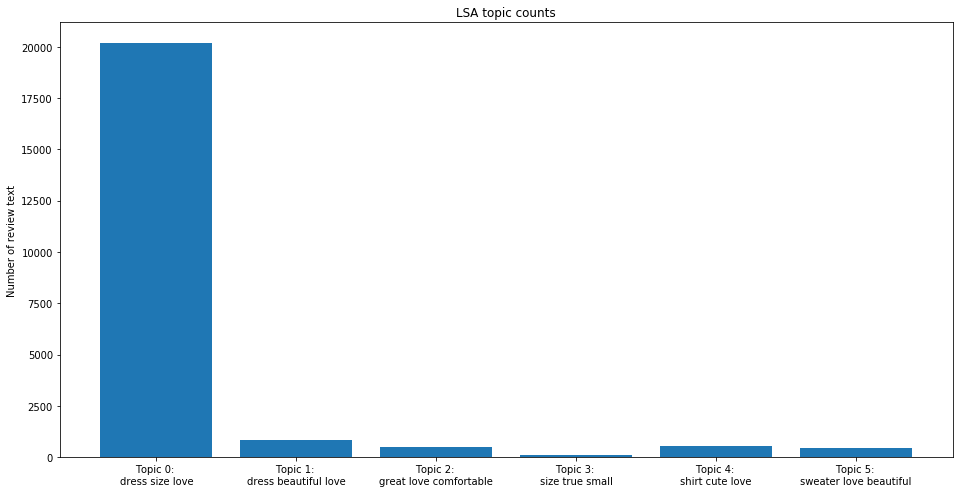

In [38]:
top_3_words = get_top_n_words(3, lsa_keys, document_term_matrix, tfidf_vectorizer)
labels = ['Topic {}: \n'.format(i) + top_3_words[i] for i in lsa_categories]

fig, ax = plt.subplots(figsize=(16,8))
ax.bar(lsa_categories, lsa_counts);
ax.set_xticks(lsa_categories);
ax.set_xticklabels(labels);
ax.set_ylabel('Number of review text');
ax.set_title('LSA topic counts');
plt.show();